# Packages

In [1]:
import os
import sys
module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path)

In [2]:
import time
import openai
import sys
from configs import (OPENAI_API_KEY, PATH_DATA_SANDBOX, STABLEDIFFUSION_API_KEY, 
                     GCP_SA_KEY, PICOVOICE_API_KEY, CLIENT_SECRETS)
from packages.core.translator import translate_multi_languages
import replicate
from PIL import Image, ImageDraw, ImageFont
import requests
from io import BytesIO

from gtts import gTTS
from rake_nltk import Rake
import nltk

import google.cloud.texttospeech as tts
from google.oauth2 import service_account
from moviepy.editor import AudioFileClip, ImageClip, VideoFileClip, concatenate_videoclips, CompositeAudioClip
from natsort import natsorted

ModuleNotFoundError: No module named 'openai'

# Create a Title from keywords

In [3]:
openai.api_key = OPENAI_API_KEY

In [4]:
youtube_trends = ["machines", "artificial inteligence", "100 years future"]
format_keywords = "Generate a title using the concepts: {}".format(", ".join(youtube_trends))
print(format_keywords)

Generate a title using the concepts: machines, artificial inteligence, 100 years future


In [5]:
response = openai.Completion.create(
              model="text-davinci-003",
              prompt=format_keywords,
              max_tokens=32,
              temperature=0.9)
title = response["choices"][0]["text"]
title = " ".join(title.split())
print(title)

A Hundred Years From Now: How Machines and Artificial Intelligence Will Shape Humanity


# Create Script from Title (chat GPT-3)

In [6]:
format_title = "Create a short story with the title: {}".format(title)
print(format_title)

Create a short story with the title: A Hundred Years From Now: How Machines and Artificial Intelligence Will Shape Humanity


In [7]:
response = openai.Completion.create(
              model="text-davinci-003",
              prompt=format_title,
              max_tokens=256*2,
              temperature=0.9)
script = response["choices"][0]["text"]
print(script)



The world of a hundred years from now had changed dramatically thanks to the advancements of artificial intelligence and robotics. Machines had taken over much of the manual labor, freeing up humanity to explore more creative endeavors. Smart machines acted as assistants to doctors, surgeons, and lawyers, allowing them to more accurately and efficiently diagnose and treat patients, while AI-powered robots served customers in restaurants, stores, and factories.

The advancements of AI had also improved humanity’s way of life in many other ways. For example, AI-driven machines were being used to develop new renewable energy sources, clean up the environment, and even help to feed the hungry by harvesting crops. All of this was thanks to the incredible advances in algorithms, automation, and robotics.

As a result of these new technologies, humans had become more connected to each other than ever before. With the help of AI-driven chatbots, conversations could be streamlined into someth

In [8]:
def paragraphs_splitter(text, rules_kw=["\n", ",", ".", ";"], min_length=5):
    paragraphs_dict = {}
    text_split = text.split()
    print("total words:", len(text_split))
    
    n_paragraphs = 0
    counter = 0
    new_paragraph = []
    for i, word in enumerate(text_split):
        new_paragraph.append(word)
        counter += 1
        if counter > min_length:
            for kw in rules_kw:
                if kw in word:
                    counter = 0
                    n_paragraphs += 1
                    paragraphs_dict["p{}".format(n_paragraphs)] = " ".join(new_paragraph)
                    new_paragraph = []

                    break
        if i + 1 == len(text_split) and len(new_paragraph) > 0:
            n_paragraphs += 1
            paragraphs_dict["p{}".format(n_paragraphs)] = " ".join(new_paragraph)
            
    
    return paragraphs_dict
    

In [9]:
paragraphs_dict = paragraphs_splitter(text=script)
paragraphs_dict

total words: 249


{'p1': 'The world of a hundred years from now had changed dramatically thanks to the advancements of artificial intelligence and robotics.',
 'p2': 'Machines had taken over much of the manual labor,',
 'p3': 'freeing up humanity to explore more creative endeavors.',
 'p4': 'Smart machines acted as assistants to doctors,',
 'p5': 'surgeons, and lawyers, allowing them to more accurately and efficiently diagnose and treat patients,',
 'p6': 'while AI-powered robots served customers in restaurants,',
 'p7': 'stores, and factories. The advancements of AI had also improved humanity’s way of life in many other ways.',
 'p8': 'For example, AI-driven machines were being used to develop new renewable energy sources,',
 'p9': 'clean up the environment, and even help to feed the hungry by harvesting crops.',
 'p10': 'All of this was thanks to the incredible advances in algorithms,',
 'p11': 'automation, and robotics. As a result of these new technologies,',
 'p12': 'humans had become more connecte

# Images (stabble diffusion)

## Cover Page

In [10]:
width=1024
height=512
num_inference_steps=90
guidance_scale=1
prompt_strength=5

In [11]:
img_path = PATH_DATA_SANDBOX / "poc2/images"
movie_dict={}
movie_dict["title"] = {}
movie_dict["title"]["title_en"] = title
prompt = title
model_name = "stability-ai/stable-diffusion"


rep_inst = replicate.Client(api_token=STABLEDIFFUSION_API_KEY)
model = rep_inst.models.get(model_name)
version = model.versions.get("f178fa7a1ae43a9a9af01b833b9d2ecf97b1bcb0acfd2dc5dd04895e042863f1")
pred = version.predict(prompt=title, 
                       num_inference_steps=num_inference_steps, 
                       guidance_scale=guidance_scale,
                       width=width, height=height)

title_output_url = pred[0]

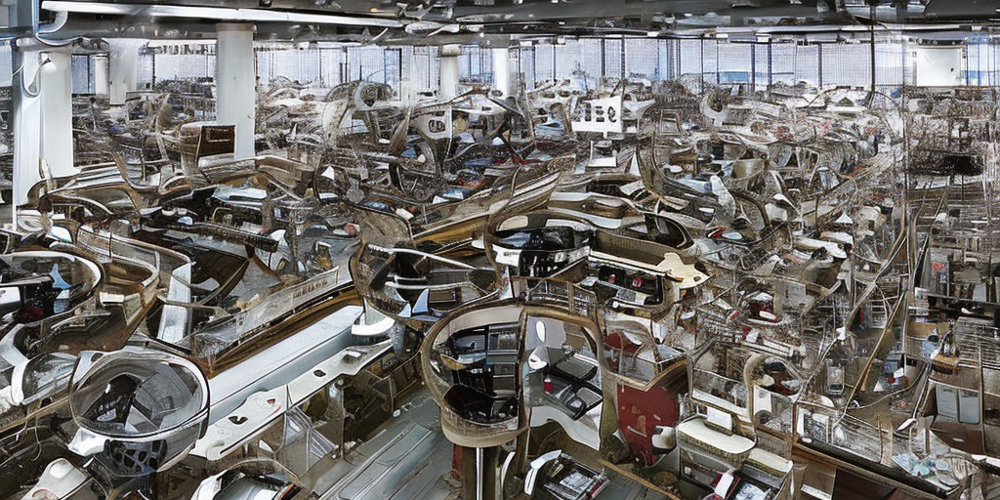

{'title': {'title_en': 'A Hundred Years From Now: How Machines and Artificial Intelligence Will Shape Humanity',
  'cover_path': 'D:\\git-projects\\ai-cinema-engine\\data\\sandbox\\poc2\\images\\cover.jpg'}}

In [12]:
response = requests.get(title_output_url)
title_img = Image.open(BytesIO(response.content))
title_img.save(img_path/"cover.jpg")
display(title_img)

movie_dict["title"]["cover_path"] = str(img_path/"cover.jpg")
movie_dict

# Keywords from phrases

In [13]:
to_down = ["punkt", 'stopwords']
rake_nltk_var = Rake()

In [14]:
def get_kwords_from_phrase(phrase, rake_nltk_var, max_token=5, fmmt_phrase="Concept art of:"):
    rake_nltk_var.extract_keywords_from_text(phrase)
    keyword_extracted = rake_nltk_var.get_ranked_phrases()
    max_token = min(max_token, len(keyword_extracted))
    return "{} {}".format(fmmt_phrase ,", ".join(keyword_extracted[:max_token]))

<p1> A movie scene where: The world of a hundred years from now had changed dramatically thanks to the advancements of artificial intelligence and robotics.


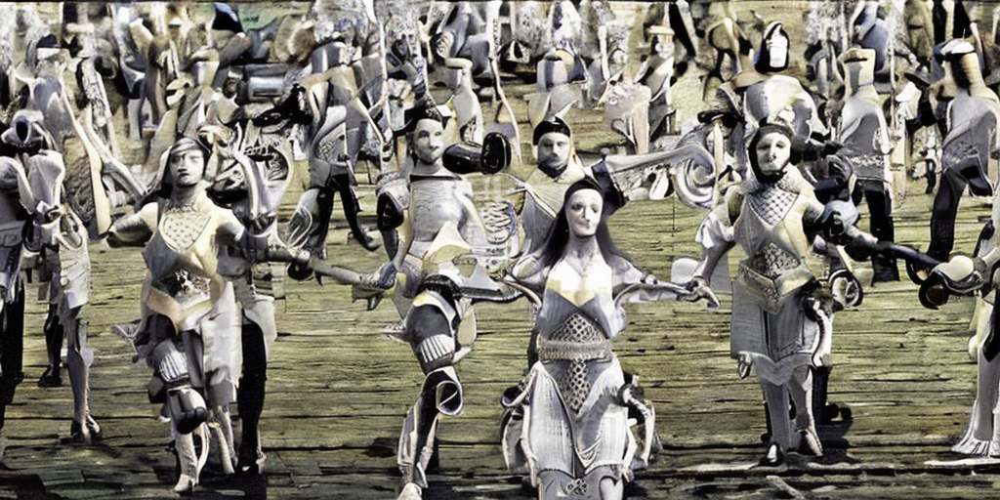

<p2> A movie scene where: Machines had taken over much of the manual labor,


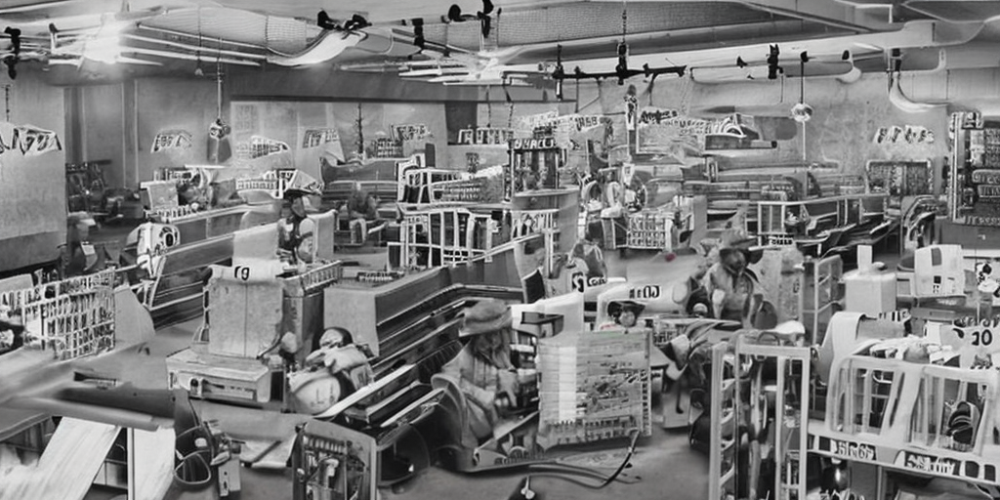

<p3> A movie scene where: freeing up humanity to explore more creative endeavors.


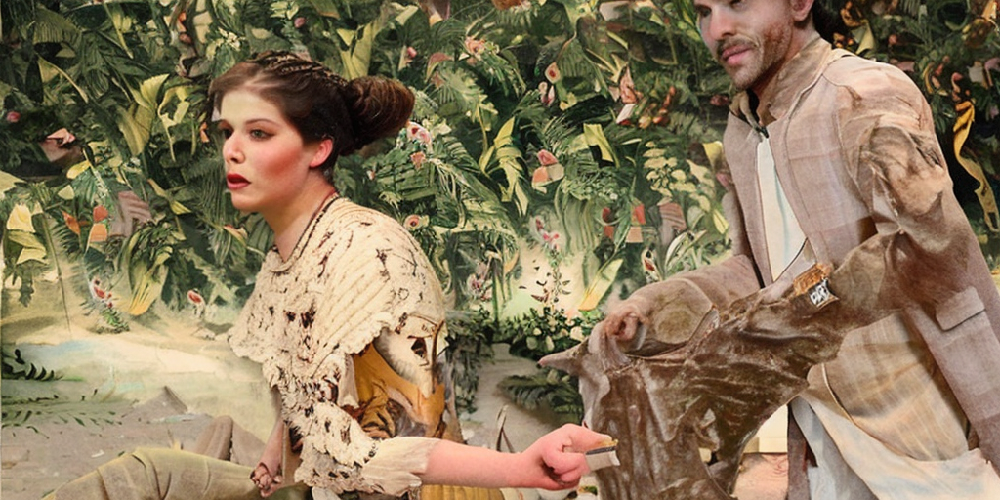

<p4> A movie scene where: Smart machines acted as assistants to doctors,


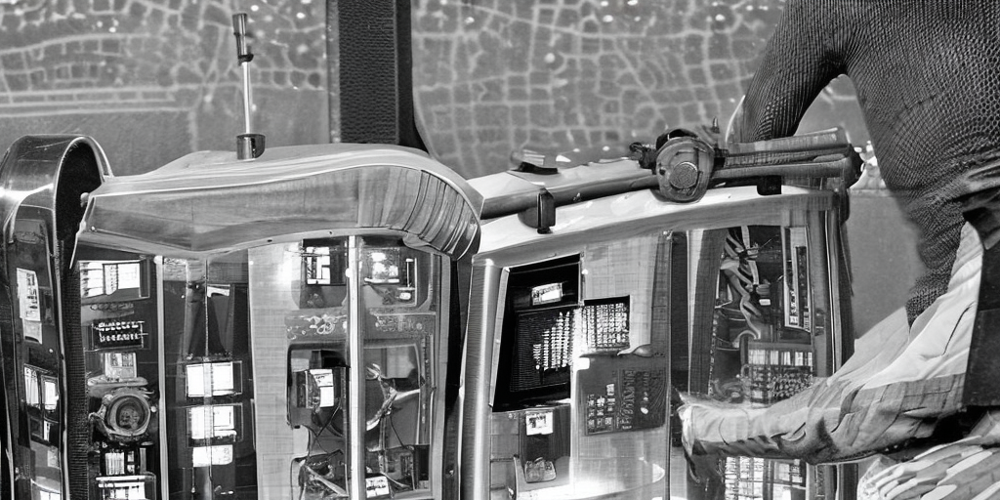

<p5> A movie scene where: surgeons, and lawyers, allowing them to more accurately and efficiently diagnose and treat patients,


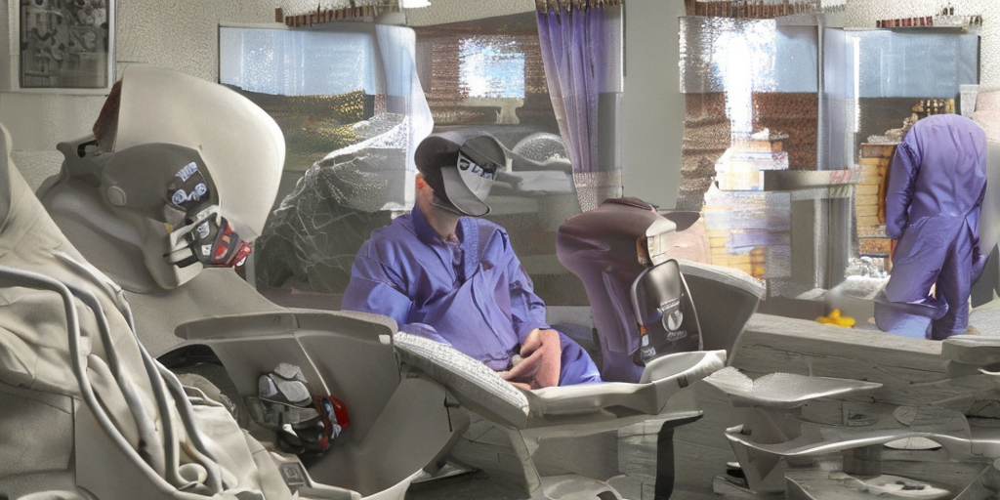

<p6> A movie scene where: while AI-powered robots served customers in restaurants,


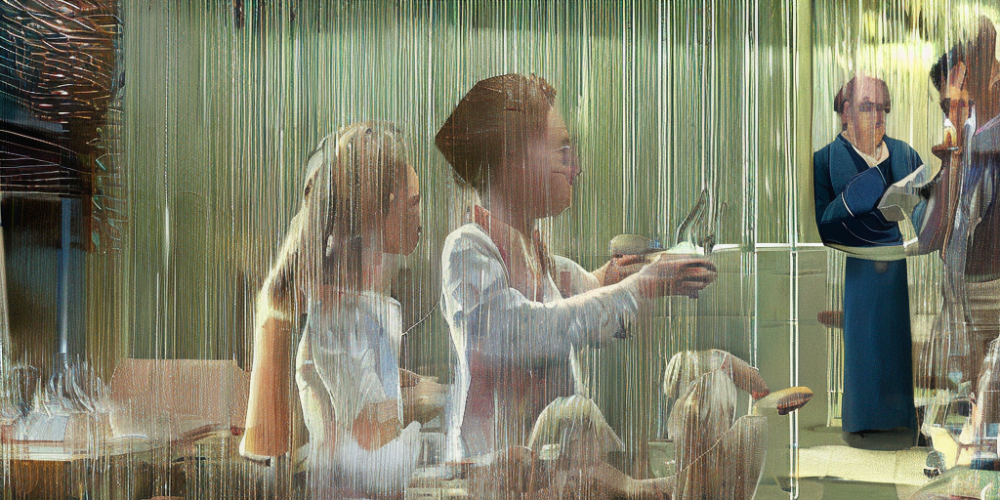

<p7> A movie scene where: stores, and factories. The advancements of AI had also improved humanity’s way of life in many other ways.


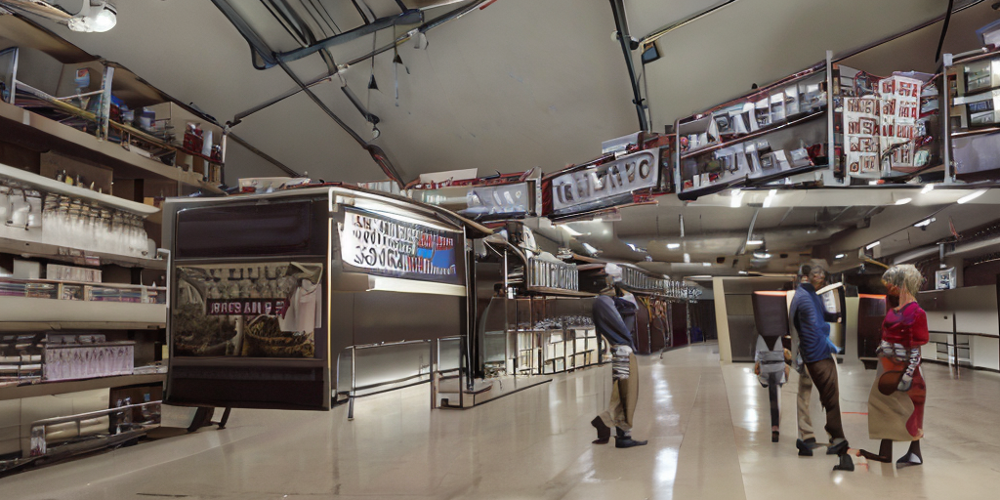

<p8> A movie scene where: For example, AI-driven machines were being used to develop new renewable energy sources,


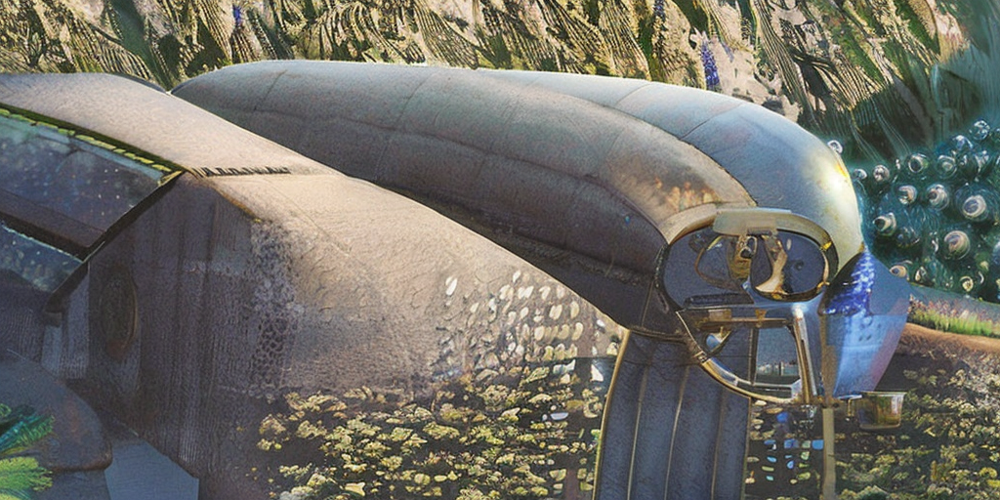

<p9> A movie scene where: clean up the environment, and even help to feed the hungry by harvesting crops.


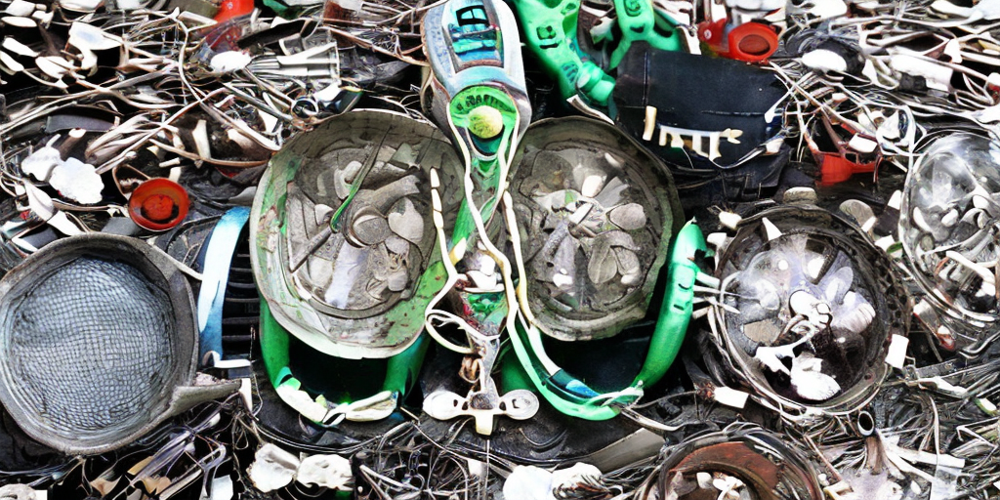

<p10> A movie scene where: All of this was thanks to the incredible advances in algorithms,


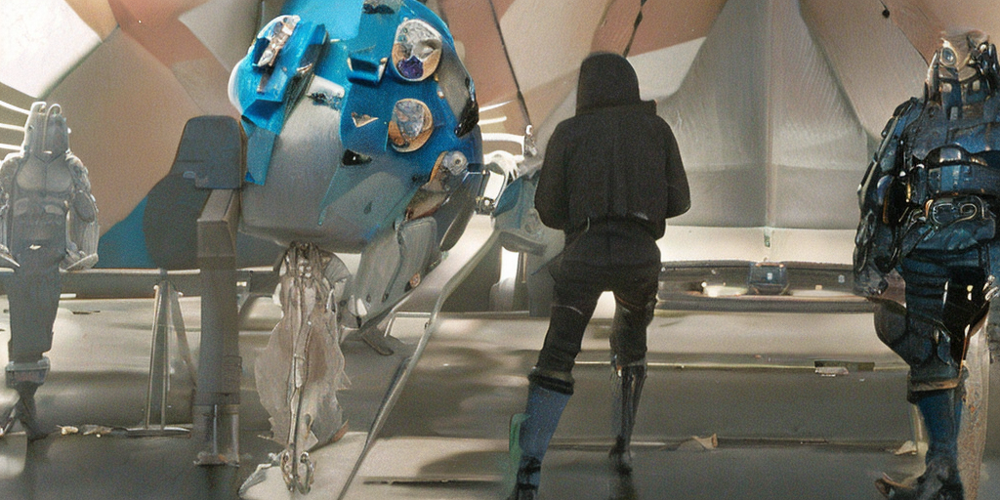

<p11> A movie scene where: automation, and robotics. As a result of these new technologies,


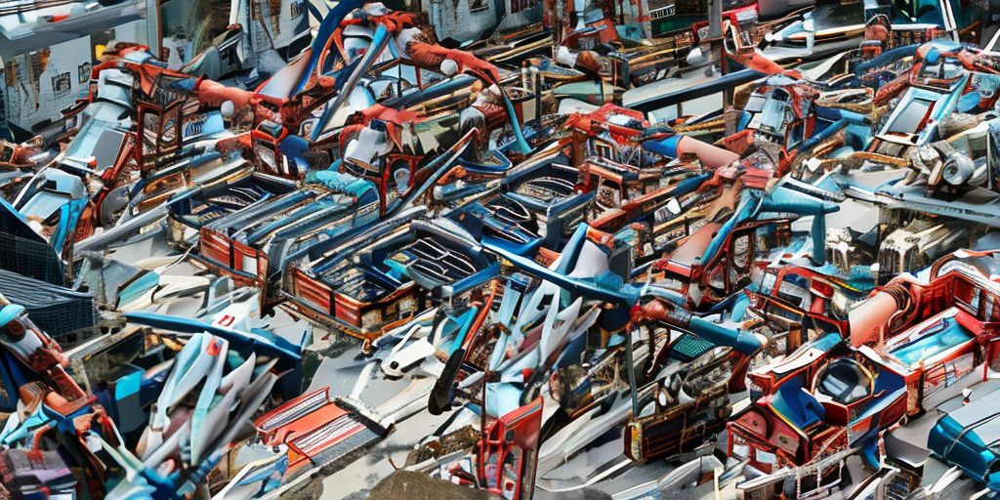

<p12> A movie scene where: humans had become more connected to each other than ever before.


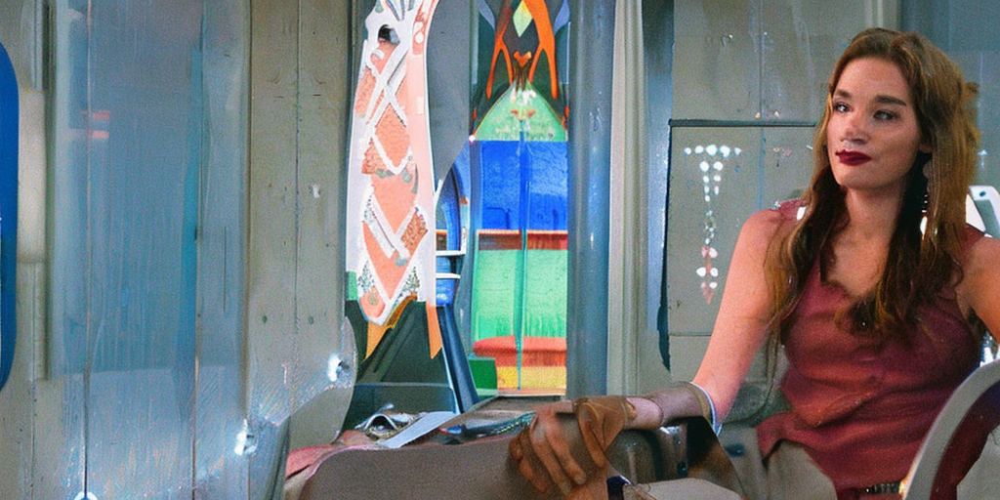

<p13> A movie scene where: With the help of AI-driven chatbots,


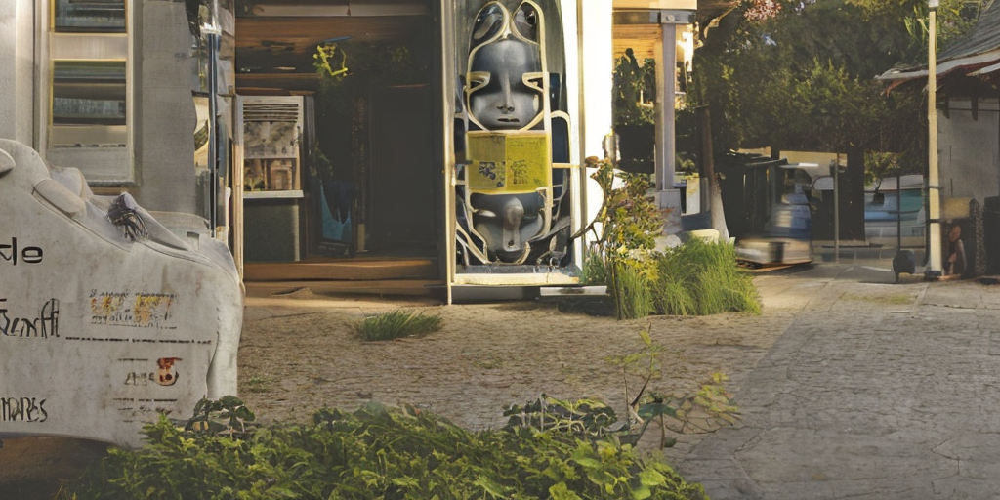

<p14> A movie scene where: conversations could be streamlined into something resembling a real conversation,


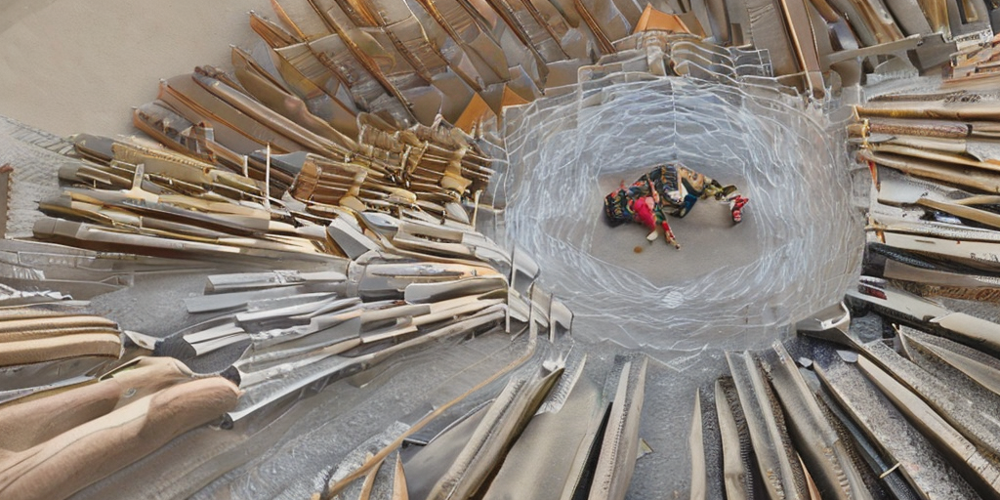

<p15> A movie scene where: leading to increased communication between people from different countries and cultures.


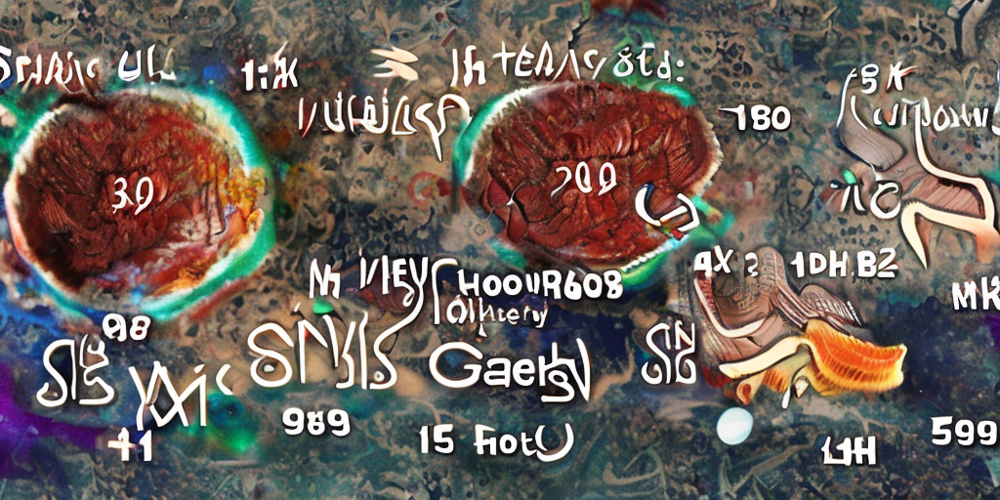

<p16> A movie scene where: Furthermore, advances in robotics had also allowed robots to take on more complex tasks.


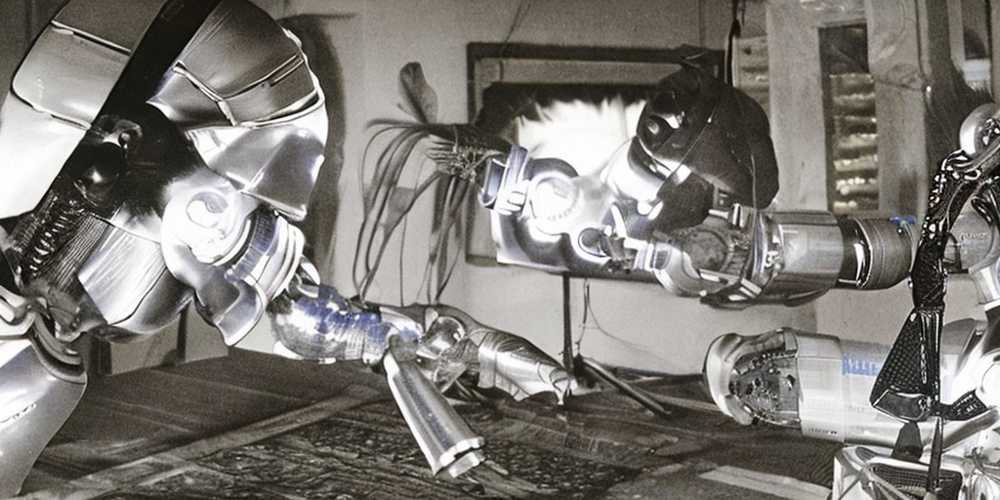

<p17> A movie scene where: Apps that used AI-driven algorithms could help with decision-making,


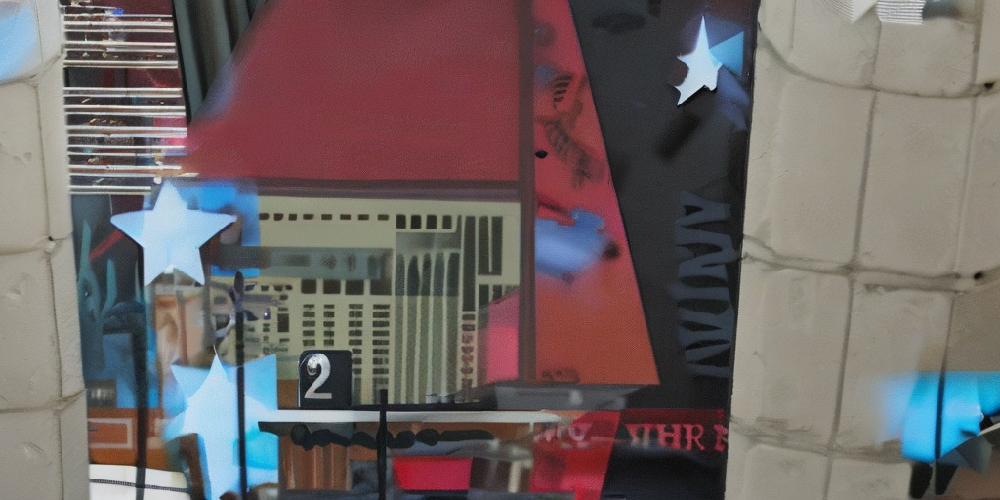

<p18> A movie scene where: craft personalized experiences, and even create music and art—all controlled by machines.


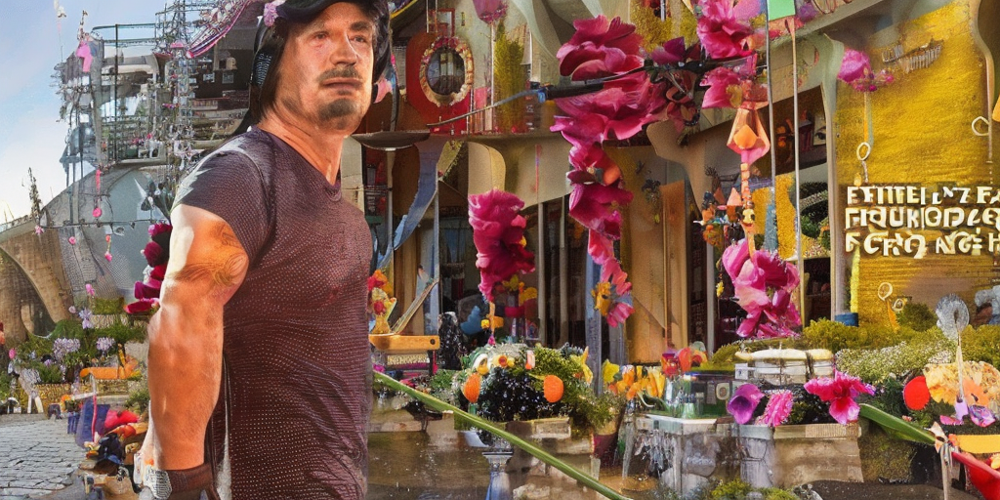

<p19> A movie scene where: In many ways, the world of a hundred years from now was a more advanced and efficient version of the world of today,


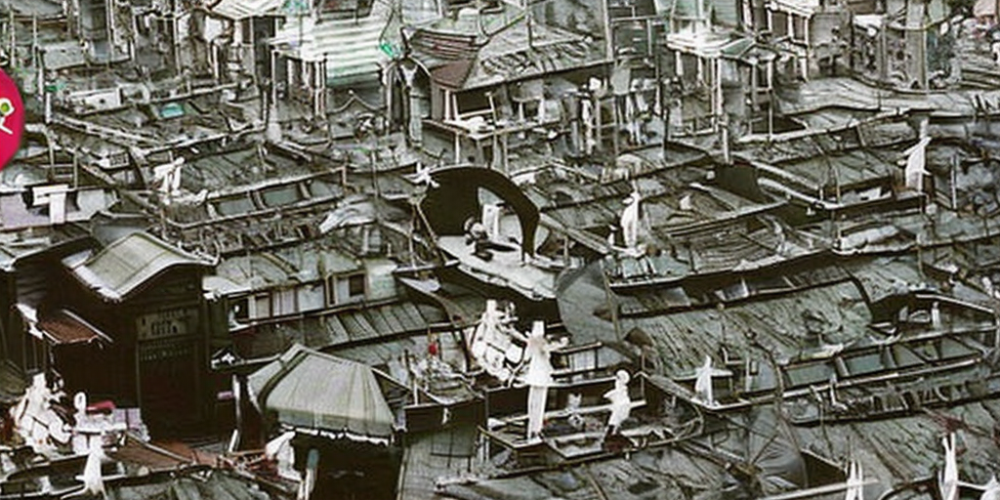

<p20> A movie scene where: thanks to advances in artificial intelligence and robotics.


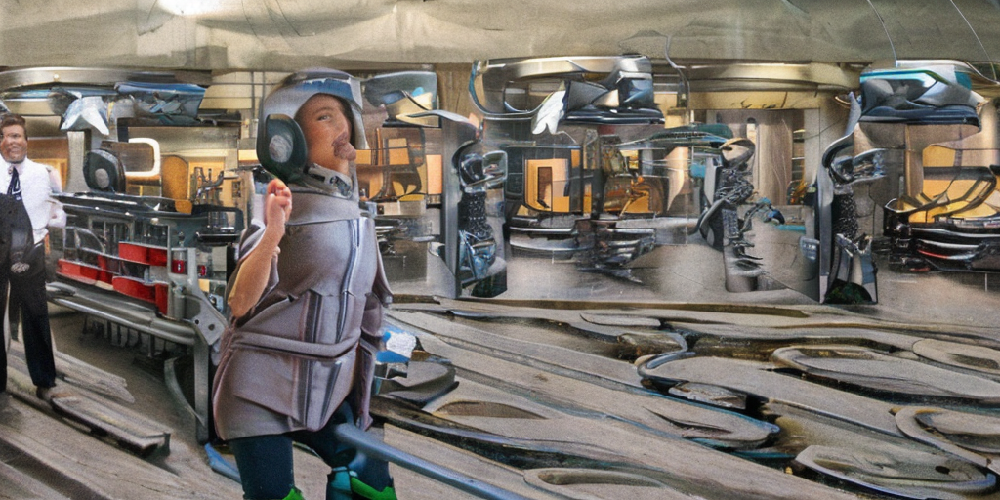

<p21> A movie scene where: Clearly, these advances had and would continue to shape humanity in many positive ways.


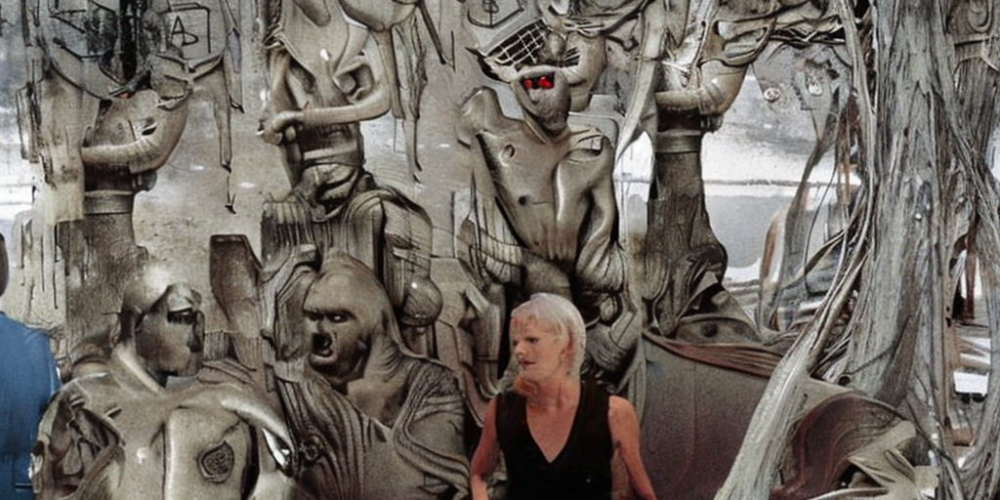

{'p1': {'script_eng': 'The world of a hundred years from now had changed dramatically thanks to the advancements of artificial intelligence and robotics.',
  'img_path': 'D:\\git-projects\\ai-cinema-engine\\data\\sandbox\\poc2\\images\\p1.jpg',
  'kwords': 'A movie scene where: The world of a hundred years from now had changed dramatically thanks to the advancements of artificial intelligence and robotics.'},
 'p2': {'script_eng': 'Machines had taken over much of the manual labor,',
  'img_path': 'D:\\git-projects\\ai-cinema-engine\\data\\sandbox\\poc2\\images\\p2.jpg',
  'kwords': 'A movie scene where: Machines had taken over much of the manual labor,'},
 'p3': {'script_eng': 'freeing up humanity to explore more creative endeavors.',
  'img_path': 'D:\\git-projects\\ai-cinema-engine\\data\\sandbox\\poc2\\images\\p3.jpg',
  'kwords': 'A movie scene where: freeing up humanity to explore more creative endeavors.'},
 'p4': {'script_eng': 'Smart machines acted as assistants to doctors,',
 

In [15]:
num_inference_steps=90
prompt_strength=8
paragraphs_dict_rich = {}
for p, txt in paragraphs_dict.items():
    #kwords = get_kwords_from_phrase(txt, rake_nltk_var, max_token=5)
    kwords = "A movie scene where: {}".format(txt)
    print("<{}> {}".format(p ,kwords))
    output_url = version.predict(prompt=kwords, init_image=title_output_url, num_inference_steps=num_inference_steps, 
                               guidance_scale=guidance_scale, prompt_strength=prompt_strength,
                               width=width, height=height)[0]
    response = requests.get(output_url)
    img = Image.open(BytesIO(response.content))
    display(img)
    path = img_path / "{}.jpg".format(p)
    img.save(path)
    paragraphs_dict_rich[p] = {"script_eng": txt, "img_path": str(path), "kwords": kwords}
    
    time.sleep(3)
    
    
paragraphs_dict_rich

# Translate to spanish

In [16]:
for p in paragraphs_dict_rich:
    script_eng = paragraphs_dict_rich[p]["script_eng"]
    script_spa = translate_multi_languages(raw_text=script_eng, output_languages=["es"])
    paragraphs_dict_rich[p]["script_spa"] = script_spa["es"]

movie_dict["content"] = paragraphs_dict_rich 
movie_dict

{'title': {'title_en': 'A Hundred Years From Now: How Machines and Artificial Intelligence Will Shape Humanity',
  'cover_path': 'D:\\git-projects\\ai-cinema-engine\\data\\sandbox\\poc2\\images\\cover.jpg'},
 'content': {'p1': {'script_eng': 'The world of a hundred years from now had changed dramatically thanks to the advancements of artificial intelligence and robotics.',
   'img_path': 'D:\\git-projects\\ai-cinema-engine\\data\\sandbox\\poc2\\images\\p1.jpg',
   'kwords': 'A movie scene where: The world of a hundred years from now had changed dramatically thanks to the advancements of artificial intelligence and robotics.',
   'script_spa': 'El mundo de cien años a partir de ahora había cambiado drásticamente gracias a los avances de la inteligencia artificial y la robótica.'},
  'p2': {'script_eng': 'Machines had taken over much of the manual labor,',
   'img_path': 'D:\\git-projects\\ai-cinema-engine\\data\\sandbox\\poc2\\images\\p2.jpg',
   'kwords': 'A movie scene where: Machines

# Text to Speech

In [34]:
cred = service_account.Credentials.from_service_account_file(GCP_SA_KEY)

def unique_languages_from_voices(voices):
    language_set = set()
    for voice in voices:
        for language_code in voice.language_codes:
            language_set.add(language_code)
    return language_set


def list_languages(credentials=cred):
    client = tts.TextToSpeechClient(credentials=credentials)
    response = client.list_voices()
    languages = unique_languages_from_voices(response.voices)

    print(f" Languages: {len(languages)} ".center(60, "-"))
    for i, language in enumerate(sorted(languages)):
        print(f"{language:>10}", end="\n" if i % 5 == 4 else "")

def list_voices(language_code=None, credentials=cred):
    client = tts.TextToSpeechClient(credentials=credentials)
    response = client.list_voices(language_code=language_code)
    voices = sorted(response.voices, key=lambda voice: voice.name)

    print(f" Voices: {len(voices)} ".center(60, "-"))
    for voice in voices:
        languages = ", ".join(voice.language_codes)
        name = voice.name
        gender = tts.SsmlVoiceGender(voice.ssml_gender).name
        rate = voice.natural_sample_rate_hertz
        print(f"{languages:<8} | {name:<24} | {gender:<8} | {rate:,} Hz")
    return voices

def text_to_wav(path, voice_name: str, text: str, credentials=cred):
    language_code = "-".join(voice_name.split("-")[:2])
    text_input = tts.SynthesisInput(text=text)
    voice_params = tts.VoiceSelectionParams(
        language_code=language_code, name=voice_name
    )
    audio_config = tts.AudioConfig(audio_encoding=tts.AudioEncoding.LINEAR16)

    client = tts.TextToSpeechClient(credentials=credentials)
    response = client.synthesize_speech(input=text_input, voice=voice_params, audio_config=audio_config)

    with open(path, "wb") as out:
        out.write(response.audio_content)
        print(f'Generated speech saved to "{path}"')

In [35]:
lv = list_voices("en")
for v in lv:
    gender = tts.SsmlVoiceGender(v.ssml_gender).name
    if gender == "FEMALE":
        continue
    path = PATH_DATA_SANDBOX / "voices_cast/{}.wav".format(v.name)
    if os.path.isfile(path):
        continue
    text_to_wav(voice_name=v.name, text=title, path=path)

----------------------- Voices: 101 ------------------------
en-AU    | en-AU-Neural2-A          | FEMALE   | 24,000 Hz
en-AU    | en-AU-Neural2-B          | MALE     | 24,000 Hz
en-AU    | en-AU-Neural2-C          | FEMALE   | 24,000 Hz
en-AU    | en-AU-Neural2-D          | MALE     | 24,000 Hz
en-AU    | en-AU-News-E             | FEMALE   | 24,000 Hz
en-AU    | en-AU-News-F             | FEMALE   | 24,000 Hz
en-AU    | en-AU-News-G             | MALE     | 24,000 Hz
en-AU    | en-AU-Standard-A         | FEMALE   | 24,000 Hz
en-AU    | en-AU-Standard-A         | FEMALE   | 24,000 Hz
en-AU    | en-AU-Standard-B         | MALE     | 24,000 Hz
en-AU    | en-AU-Standard-B         | MALE     | 24,000 Hz
en-AU    | en-AU-Standard-C         | FEMALE   | 24,000 Hz
en-AU    | en-AU-Standard-C         | FEMALE   | 24,000 Hz
en-AU    | en-AU-Standard-D         | MALE     | 24,000 Hz
en-AU    | en-AU-Standard-D         | MALE     | 24,000 Hz
en-AU    | en-AU-Wavenet-A          | FEMALE   | 24,00

In [36]:
voice_name ="en-US-News-N"
path = PATH_DATA_SANDBOX / "poc2/speech/cover_eng.wav"
text_to_wav(voice_name=voice_name, 
            text=movie_dict["title"]["title_en"],path=path)
movie_dict["title"]["path_speech_en"] = str(path) 

Generated speech saved to "D:\git-projects\ai-cinema-engine\data\sandbox\poc2\speech\cover_eng.wav"


In [37]:
for p in movie_dict["content"]:
    script = movie_dict["content"][p]["script_eng"]
    path_speech = PATH_DATA_SANDBOX / "poc2/speech/{}_eng.wav".format(p)
    text_to_wav(voice_name=voice_name, text=script,
                path=path_speech)
    movie_dict["content"][p]["speech_eng"]=str(path_speech)
movie_dict

Generated speech saved to "D:\git-projects\ai-cinema-engine\data\sandbox\poc2\speech\p1_eng.wav"
Generated speech saved to "D:\git-projects\ai-cinema-engine\data\sandbox\poc2\speech\p2_eng.wav"
Generated speech saved to "D:\git-projects\ai-cinema-engine\data\sandbox\poc2\speech\p3_eng.wav"
Generated speech saved to "D:\git-projects\ai-cinema-engine\data\sandbox\poc2\speech\p4_eng.wav"
Generated speech saved to "D:\git-projects\ai-cinema-engine\data\sandbox\poc2\speech\p5_eng.wav"
Generated speech saved to "D:\git-projects\ai-cinema-engine\data\sandbox\poc2\speech\p6_eng.wav"
Generated speech saved to "D:\git-projects\ai-cinema-engine\data\sandbox\poc2\speech\p7_eng.wav"
Generated speech saved to "D:\git-projects\ai-cinema-engine\data\sandbox\poc2\speech\p8_eng.wav"
Generated speech saved to "D:\git-projects\ai-cinema-engine\data\sandbox\poc2\speech\p9_eng.wav"
Generated speech saved to "D:\git-projects\ai-cinema-engine\data\sandbox\poc2\speech\p10_eng.wav"
Generated speech saved to "D:

{'title': {'title_en': 'A Hundred Years From Now: How Machines and Artificial Intelligence Will Shape Humanity',
  'cover_path': 'D:\\git-projects\\ai-cinema-engine\\data\\sandbox\\poc2\\images\\cover.jpg',
  'path_speech_en': 'D:\\git-projects\\ai-cinema-engine\\data\\sandbox\\poc2\\speech\\cover_eng.wav'},
 'content': {'p1': {'script_eng': 'The world of a hundred years from now had changed dramatically thanks to the advancements of artificial intelligence and robotics.',
   'img_path': 'D:\\git-projects\\ai-cinema-engine\\data\\sandbox\\poc2\\images\\p1.jpg',
   'kwords': 'A movie scene where: The world of a hundred years from now had changed dramatically thanks to the advancements of artificial intelligence and robotics.',
   'script_spa': 'El mundo de cien años a partir de ahora había cambiado drásticamente gracias a los avances de la inteligencia artificial y la robótica.',
   'speech_eng': 'D:\\git-projects\\ai-cinema-engine\\data\\sandbox\\poc2\\speech\\p1_eng.wav'},
  'p2': {'s

## Combine speech + music + images

In [38]:

def add_static_image_to_audio(image_path, audio_path, output_path):
    """Create and save a video file to `output_path` after
    combining a static image that is located in `image_path`
    with an audio file in `audio_path`"""
    # create the audio clip object
    audio_clip = AudioFileClip(audio_path)
    # create the image clip object
    image_clip = ImageClip(image_path, ismask=False)
    # use set_audio method from image clip to combine the audio with the image
    video_clip = image_clip.set_audio(audio_clip)
    # specify the duration of the new clip to be the duration of the audio clip
    video_clip.duration = audio_clip.duration
    # set the FPS to 1
    video_clip.fps = audio_clip.duration*2
    # write the resuling video clip
    video_clip.write_videofile(output_path)

In [39]:
speech_cover = movie_dict["title"]["path_speech_en"]
image_cover = str(img_path/"cover.jpg")

add_static_image_to_audio(image_path=image_cover, audio_path=speech_cover, output_path=str(PATH_DATA_SANDBOX/"poc2/videos/cover.mp4"))

Moviepy - Building video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\cover.mp4.
MoviePy - Writing audio in coverTEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\cover.mp4



Moviepy - Done !
Moviepy - video ready D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\cover.mp4


In [40]:
for p, cont in movie_dict["content"].items():
    output_path = str(PATH_DATA_SANDBOX / "poc2/videos/{}.mp4".format(p))
    image_path = cont["img_path"]
    audio_path = cont["speech_eng"]
    add_static_image_to_audio(image_path=image_path, audio_path=audio_path, output_path=output_path)

Moviepy - Building video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p1.mp4.
MoviePy - Writing audio in p1TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p1.mp4



Moviepy - Done !
Moviepy - video ready D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p1.mp4
Moviepy - Building video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p2.mp4.
MoviePy - Writing audio in p2TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p2.mp4



Moviepy - Done !
Moviepy - video ready D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p2.mp4
Moviepy - Building video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p3.mp4.
MoviePy - Writing audio in p3TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p3.mp4



Moviepy - Done !
Moviepy - video ready D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p3.mp4
Moviepy - Building video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p4.mp4.
MoviePy - Writing audio in p4TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p4.mp4



Moviepy - Done !
Moviepy - video ready D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p4.mp4
Moviepy - Building video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p5.mp4.
MoviePy - Writing audio in p5TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p5.mp4



Moviepy - Done !
Moviepy - video ready D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p5.mp4
Moviepy - Building video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p6.mp4.
MoviePy - Writing audio in p6TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p6.mp4



Moviepy - Done !
Moviepy - video ready D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p6.mp4
Moviepy - Building video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p7.mp4.
MoviePy - Writing audio in p7TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p7.mp4



Moviepy - Done !
Moviepy - video ready D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p7.mp4
Moviepy - Building video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p8.mp4.
MoviePy - Writing audio in p8TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p8.mp4



Moviepy - Done !
Moviepy - video ready D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p8.mp4
Moviepy - Building video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p9.mp4.
MoviePy - Writing audio in p9TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p9.mp4



Moviepy - Done !
Moviepy - video ready D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p9.mp4
Moviepy - Building video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p10.mp4.
MoviePy - Writing audio in p10TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p10.mp4



Moviepy - Done !
Moviepy - video ready D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p10.mp4
Moviepy - Building video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p11.mp4.
MoviePy - Writing audio in p11TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p11.mp4



Moviepy - Done !
Moviepy - video ready D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p11.mp4
Moviepy - Building video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p12.mp4.
MoviePy - Writing audio in p12TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p12.mp4



Moviepy - Done !
Moviepy - video ready D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p12.mp4
Moviepy - Building video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p13.mp4.
MoviePy - Writing audio in p13TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p13.mp4



Moviepy - Done !
Moviepy - video ready D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p13.mp4
Moviepy - Building video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p14.mp4.
MoviePy - Writing audio in p14TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p14.mp4



Moviepy - Done !
Moviepy - video ready D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p14.mp4
Moviepy - Building video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p15.mp4.
MoviePy - Writing audio in p15TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p15.mp4



Moviepy - Done !
Moviepy - video ready D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p15.mp4
Moviepy - Building video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p16.mp4.
MoviePy - Writing audio in p16TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p16.mp4



Moviepy - Done !
Moviepy - video ready D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p16.mp4
Moviepy - Building video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p17.mp4.
MoviePy - Writing audio in p17TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p17.mp4



Moviepy - Done !
Moviepy - video ready D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p17.mp4
Moviepy - Building video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p18.mp4.
MoviePy - Writing audio in p18TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p18.mp4



Moviepy - Done !
Moviepy - video ready D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p18.mp4
Moviepy - Building video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p19.mp4.
MoviePy - Writing audio in p19TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p19.mp4



Moviepy - Done !
Moviepy - video ready D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p19.mp4
Moviepy - Building video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p20.mp4.
MoviePy - Writing audio in p20TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p20.mp4



Moviepy - Done !
Moviepy - video ready D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p20.mp4
Moviepy - Building video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p21.mp4.
MoviePy - Writing audio in p21TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p21.mp4



Moviepy - Done !
Moviepy - video ready D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\p21.mp4


# Merge Videos

In [41]:
L = []
path_merged_video = str(PATH_DATA_SANDBOX/"poc2/videos/output.mp4")

for root, dirs, files in os.walk(PATH_DATA_SANDBOX/"poc2/videos"):

    #files.sort()
    files = natsorted(files)
    for file in files:
        if os.path.splitext(file)[1] == '.mp4':
            if file.startswith("p") or file.startswith("cover"):
                filePath = os.path.join(root, file)
                video = VideoFileClip(filePath)
                L.append(video)

final_clip = concatenate_videoclips(L)
final_clip.to_videofile(path_merged_video, fps=24, remove_temp=False)

Moviepy - Building video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\output.mp4.
MoviePy - Writing audio in outputTEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\output.mp4



Moviepy - Done !
Moviepy - video ready D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\output.mp4


## Add Background Music

In [42]:
video_clip = VideoFileClip(path_merged_video)
audio_clip = AudioFileClip(str(PATH_DATA_SANDBOX/"poc2/bg_music.mp3"))
audio_clip = audio_clip.volumex(0.05)
audio_clip = audio_clip.subclip(video_clip.start, video_clip.end)
final_audio = CompositeAudioClip([video_clip.audio, audio_clip])
final_clip = video_clip.set_audio(final_audio)
final_clip.write_videofile(str(PATH_DATA_SANDBOX/"poc2/videos/final.mp4"))

Moviepy - Building video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\final.mp4.
MoviePy - Writing audio in finalTEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\final.mp4



Moviepy - Done !
Moviepy - video ready D:\git-projects\ai-cinema-engine\data\sandbox\poc2\videos\final.mp4


# Add subtitles

In [43]:
import pvleopard

PICOVOICE_API_KEY = ""
access_key = PICOVOICE_API_KEY
leopard = pvleopard.create(access_key=access_key)

In [48]:
video_path = str(PATH_DATA_SANDBOX/"poc2/videos/final.mp4")
audio_path = str(PATH_DATA_SANDBOX/"poc2/speech/final.mp3")
my_clip = VideoFileClip(video_path)
my_clip.audio.write_audiofile(audio_path)
transcript, words = leopard.process_file(audio_path)

MoviePy - Writing audio in D:\git-projects\ai-cinema-engine\data\sandbox\poc2\speech\final.mp3


MoviePy - Done.


In [49]:
def second_to_timecode(x: float) -> str:
    hour, x = divmod(x, 3600)
    minute, x = divmod(x, 60)
    second, x = divmod(x, 1)
    millisecond = int(x * 1000.)

    return '%.2d:%.2d:%.2d,%.3d' % (hour, minute, second, millisecond)

def to_srt(
        words,
        endpoint_sec: float = 1.,
        length_limit = 16) -> str:
    def _helper(end: int) -> None:
        lines.append("%d" % section)
        lines.append(
            "%s --> %s" %
            (
                second_to_timecode(words[start].start_sec),
                second_to_timecode(words[end].end_sec)
            )
        )
        lines.append(' '.join(x.word for x in words[start:(end + 1)]))
        lines.append('')

    lines = list()
    section = 0
    start = 0
    for k in range(1, len(words)):
        if ((words[k].start_sec - words[k - 1].end_sec) >= endpoint_sec) or \
                (length_limit is not None and (k - start) >= length_limit):
            _helper(k - 1)
            start = k
            section += 1
    _helper(len(words) - 1)

    return '\n'.join(lines)

In [50]:
captions = to_srt(words)
captions_spa = []

for i,elemt in enumerate(captions.split("\n")):
    if i == 2 or (i-2)%4 == 0:
        elemt_fmmt = translate_multi_languages(raw_text=elemt, output_languages=["es"])["es"]
    else:
        elemt_fmmt = elemt
    captions_spa.append(elemt_fmmt)

captions_spa = "\n".join(captions_spa)
captions_spa

'0\n00:00:00,096 --> 00:00:05,343\nA partir de ahora, cómo las máquinas y la inteligencia artificial darán forma a la humanidad el mundo de\n\n1\n00:00:05,375 --> 00:00:09,855\ndentro de cien años habían cambiado drásticamente gracias a los avances de la inteligencia artificial y\n\n2\n00:00:09,887 --> 00:00:15,487\nLas máquinas de robótica se habían hecho cargo de gran parte del trabajo manual liberando a la humanidad para explorar más\n\n3\n00:00:15,583 --> 00:00:21,823\nLos esfuerzos creativos de las máquinas inteligentes actuaron como asistencia para los médicos de los cirujanos y abogados que les permiten más\n\n4\n00:00:21,920 --> 00:00:28,832\ndiagnosticar y tratar de manera precisa y eficiente a los pacientes mientras que los robots funcionaban sirvieron a los clientes y tiendas de restaurantes\n\n5\n00:00:28,992 --> 00:00:33,472\ny fábricas Los avances de la IA también habían mejorado la forma de vida de la humanidad en muchas otras\n\n6\n00:00:33,599 --> 00:00:40,159\nManeras

In [51]:
captions_dict = dict(zip(["eng", "spa"], [captions, captions_spa]))
for lng, cap in captions_dict.items():
    subtitle_path = PATH_DATA_SANDBOX / "poc2/captions/captions_{}.srt".format(lng)
    with open(subtitle_path, 'w') as f:
        f.write(cap)

# Upload to Youtube

In [6]:
import pickle
import os
from google_auth_oauthlib.flow import Flow, InstalledAppFlow
from googleapiclient.discovery import build
from googleapiclient.http import MediaFileUpload, MediaIoBaseDownload
from google.auth.transport.requests import Request


def Create_Service(client_secret_file, api_name, api_version, *scopes):
    print(client_secret_file, api_name, api_version, scopes, sep='-')
    CLIENT_SECRET_FILE = client_secret_file
    API_SERVICE_NAME = api_name
    API_VERSION = api_version
    SCOPES = [scope for scope in scopes[0]]
    print(SCOPES)

    cred = None

    pickle_file = f'token_{API_SERVICE_NAME}_{API_VERSION}.pickle'
    # print(pickle_file)

    if os.path.exists(pickle_file):
        with open(pickle_file, 'rb') as token:
            cred = pickle.load(token)

    if not cred or not cred.valid:
        if cred and cred.expired and cred.refresh_token:
            cred.refresh(Request())
        else:
            flow = InstalledAppFlow.from_client_secrets_file(CLIENT_SECRET_FILE, SCOPES)
            cred = flow.run_local_server()

        with open(pickle_file, 'wb') as token:
            pickle.dump(cred, token)

    try:
        service = build(API_SERVICE_NAME, API_VERSION, credentials=cred)
        print(API_SERVICE_NAME, 'service created successfully')
        return service
    except Exception as e:
        print('Unable to connect.')
        print(e)
        return None

def convert_to_RFC_datetime(year=1900, month=1, day=1, hour=0, minute=0):
    dt = datetime.datetime(year, month, day, hour, minute, 0).isoformat() + 'Z'
    return dt

In [12]:
client_secret_file = str(CLIENT_SECRETS)
api_name = "youtube"
api_version = "v3"
scopes=["https://www.googleapis.com/auth/youtube.upload"]

service = Create_Service(client_secret_file, api_name, api_version, scopes)

D:\git-projects\ai-cinema-engine\statics\keys\client_secrets.json-youtube-v3-(['https://www.googleapis.com/auth/youtube.upload'],)
['https://www.googleapis.com/auth/youtube.upload']
Please visit this URL to authorize this application: https://accounts.google.com/o/oauth2/auth?response_type=code&client_id=84765843005-q2ge7ejbrtj0t201uki9e5o1oq4623np.apps.googleusercontent.com&redirect_uri=http%3A%2F%2Flocalhost%3A8080%2F&scope=https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fyoutube.upload&state=nfzriec7Gje3ORz1MVtKBhZ7Eyoryc&access_type=offline
youtube service created successfully


In [15]:
description = """
Video Generate using 100% Artificial Intelligence.
"""

In [16]:
request_body = {
    "snippet": {
        "title": "(PoC 2) A Hundred Years From Now: How Machines and Artificial Intelligence Will Shape Humanity",
        "description": description,
        "tags": ["artificial intelligence", "future", "machines", "stabble diffusion", "chatGPT"]
    },
    "status": {
        "privecyStatus": "public",
        "selfDeclareMadeForKids": False
    }
}
request_body

{'snippet': {'title': '(PoC 2) A Hundred Years From Now: How Machines and Artificial Intelligence Will Shape Humanity',
  'description': '\nVideo Generate using 100% Artificial Intelligence.\n',
  'tags': ['artificial intelligence',
   'future',
   'machines',
   'stabble diffusion',
   'chatGPT']},
 'status': {'privecyStatus': 'public', 'selfDeclareMadeForKids': False}}

In [19]:
media_file = MediaFileUpload(str(PATH_DATA_SANDBOX/"poc2/videos/final.mp4"))

response_upload = service.videos().insert(part="snippet,status", body=request_body, media_body=media_file).execute()


In [20]:
response_upload

{'kind': 'youtube#video',
 'etag': '7orDaGrwJBH1EYPxCMTKM7nhIVo',
 'id': 'c5PiZKMSd0Y',
 'snippet': {'publishedAt': '2023-01-13T22:14:32Z',
  'channelId': 'UCP3Y3z8Aw_pHSkodHdrLTUA',
  'title': '(PoC 2) A Hundred Years From Now: How Machines and Artificial Intelligence Will Shape Humanity',
  'description': 'Video Generate using 100% Artificial Intelligence.',
  'thumbnails': {'default': {'url': 'https://i.ytimg.com/vi/c5PiZKMSd0Y/default.jpg',
    'width': 120,
    'height': 90},
   'medium': {'url': 'https://i.ytimg.com/vi/c5PiZKMSd0Y/mqdefault.jpg',
    'width': 320,
    'height': 180},
   'high': {'url': 'https://i.ytimg.com/vi/c5PiZKMSd0Y/hqdefault.jpg',
    'width': 480,
    'height': 360}},
  'channelTitle': 'Franco Zentilli Traverso',
  'tags': ['artificial intelligence',
   'chatGPT',
   'future',
   'machines',
   'stabble diffusion'],
  'categoryId': '19',
  'liveBroadcastContent': 'none',
  'localized': {'title': '(PoC 2) A Hundred Years From Now: How Machines and Artificia

## TODO: 
- automatizar cover imagen
- captions upload


In [5]:
pip install google_auth_oauthlib

  Using cached requests_oauthlib-1.3.1-py2.py3-none-any.whl (23 kB)
Note: you may need to restart the kernel to use updated packages.


ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-cloud-storage 1.28.1 requires google-auth<2.0dev,>=1.11.0, but you have google-auth 2.16.0 which is incompatible.
google-cloud-storage 1.28.1 requires google-cloud-core<2.0dev,>=1.2.0, but you have google-cloud-core 2.2.2 which is incompatible.


     ------------------------------------- 177.8/177.8 kB 10.5 MB/s eta 0:00:00
  Using cached oauthlib-3.2.2-py3-none-any.whl (151 kB)
  Attempting uninstall: google-auth
    Found existing installation: google-auth 2.6.0
    Uninstalling google-auth-2.6.0:
      Successfully uninstalled google-auth-2.6.0


google-cloud-storage 1.28.1 requires google-resumable-media<0.6dev,>=0.5.0, but you have google-resumable-media 2.1.0 which is incompatible.
google-cloud-logging 1.15.0 requires google-api-core[grpc]<2.0.0dev,>=1.15.0, but you have google-api-core 2.10.2 which is incompatible.
google-cloud-logging 1.15.0 requires google-cloud-core<2.0dev,>=1.1.0, but you have google-cloud-core 2.2.2 which is incompatible.


In [3]:
from Google import Create_Service

ModuleNotFoundError: No module named 'Google'

In [2]:
pip install Google

In [52]:
#import httplib
import http.client
import httplib2
import os
import random
import sys
import time

from apiclient.discovery import build
from apiclient.errors import HttpError
from apiclient.http import MediaFileUpload
from oauth2client.client import flow_from_clientsecrets
from oauth2client.file import Storage
from oauth2client.tools import argparser, run_flow

In [70]:
# Explicitly tell the underlying HTTP transport library not to retry, since
# we are handling retry logic ourselves.
httplib2.RETRIES = 1

# Maximum number of times to retry before giving up.
MAX_RETRIES = 10

# Always retry when these exceptions are raised.
RETRIABLE_EXCEPTIONS = (httplib2.HttpLib2Error, IOError, 
                        http.client.NotConnected,
                        http.client.IncompleteRead, 
                        http.client.ImproperConnectionState,
                        http.client.CannotSendRequest, 
                        http.client.CannotSendHeader,
                        http.client.ResponseNotReady, 
                        http.client.BadStatusLine)

# Always retry when an apiclient.errors.HttpError with one of these status
# codes is raised.
RETRIABLE_STATUS_CODES = [500, 502, 503, 504]

# The CLIENT_SECRETS_FILE variable specifies the name of a file that contains
# the OAuth 2.0 information for this application, including its client_id and
# client_secret. You can acquire an OAuth 2.0 client ID and client secret from
# the Google API Console at
# https://console.cloud.google.com/.
# Please ensure that you have enabled the YouTube Data API for your project.
# For more information about using OAuth2 to access the YouTube Data API, see:
#   https://developers.google.com/youtube/v3/guides/authentication
# For more information about the client_secrets.json file format, see:
#   https://developers.google.com/api-client-library/python/guide/aaa_client_secrets
CLIENT_SECRETS_FILE = str(CLIENT_SECRETS)

# This OAuth 2.0 access scope allows an application to upload files to the
# authenticated user's YouTube channel, but doesn't allow other types of access.
YOUTUBE_UPLOAD_SCOPE = "https://www.googleapis.com/auth/youtube.upload"
YOUTUBE_API_SERVICE_NAME = "youtube"
YOUTUBE_API_VERSION = "v3"

# This variable defines a message to display if the CLIENT_SECRETS_FILE is
# missing.
MISSING_CLIENT_SECRETS_MESSAGE = "--"
VALID_PRIVACY_STATUSES = ("public", "private", "unlisted")


In [82]:
def get_authenticated_service(args):
    flow = flow_from_clientsecrets(CLIENT_SECRETS_FILE,
                                   scope=YOUTUBE_UPLOAD_SCOPE,
                                   message=MISSING_CLIENT_SECRETS_MESSAGE)
    storage = Storage("%s-oauth2.json" % sys.argv[0])
    credentials = storage.get()

    if credentials is None or credentials.invalid:
        credentials = run_flow(flow, storage, args)
    
    return build(YOUTUBE_API_SERVICE_NAME, YOUTUBE_API_VERSION,
                 http=credentials.authorize(httplib2.Http()))

def initialize_upload(youtube, options):
    tags = None
    if options.keywords:
        tags = options.keywords.split(",")
    
    body=dict(snippet=dict(title=options.title,
                           description=options.description,
                           tags=tags,
                           categoryId=options.category),
              status=dict(privacyStatus=options.privacyStatus))
    # Call the API's videos.insert method to create and upload the video.
    insert_request = youtube.videos().insert(part=",".join(body.keys()),
                                             body=body,
                                             media_body=MediaFileUpload(options.file, chunksize=-1, resumable=True))
    # The chunksize parameter specifies the size of each chunk of data, in
    # bytes, that will be uploaded at a time. Set a higher value for
    # reliable connections as fewer chunks lead to faster uploads. Set a lower
    # value for better recovery on less reliable connections.
    #
    # Setting "chunksize" equal to -1 in the code below means that the entire
    # file will be uploaded in a single HTTP request. (If the upload fails,
    # it will still be retried where it left off.) This is usually a best
    # practice, but if you're using Python older than 2.6 or if you're
    # running on App Engine, you should set the chunksize to something like
    # 1024 * 1024 (1 megabyte).
    resumable_upload(insert_request)
    
# This method implements an exponential backoff strategy to resume a
# failed upload.
def resumable_upload(insert_request):
    response = None
    error = None
    retry = 0
    while response is None:
        try:
            print("Uploading file...")
            status, response = insert_request.next_chunk()
            if response is not None:
                if 'id' in response:
                    print("Video id '%s' was successfully uploaded." % response['id'])
                else:
                    exit("The upload failed with an unexpected response: %s" % response)
        except HttpError as e:
            if e.resp.status in RETRIABLE_STATUS_CODES:
                error = "A retriable HTTP error %d occurred:\n%s" % (e.resp.status,
                                                                     e.content)
            else:
                raise
        except RETRIABLE_EXCEPTIONS as e:
            error = "A retriable error occurred: %s" % e

        if error is not None:
            print(error)
            retry += 1
            if retry > MAX_RETRIES:
                exit("No longer attempting to retry.")

            max_sleep = 2 ** retry
            sleep_seconds = random.random() * max_sleep
            print("Sleeping %f seconds and then retrying..." % sleep_seconds)
            time.sleep(sleep_seconds)

In [83]:
description = """
Video Generate using 100% Artificial Intelligence.
"""

In [84]:
args = {"file": str(PATH_DATA_SANDBOX/"poc2/videos/final.mp4"),
        "title": title, 
        "description": description,
        "keywords": "artificial intelligence, future, machines, stabble diffusion, chatGPT",
        "privacyStatus": "public"
       }
args

{'file': 'D:\\git-projects\\ai-cinema-engine\\data\\sandbox\\poc2\\videos\\final.mp4',
 'title': 'A Hundred Years From Now: How Machines and Artificial Intelligence Will Shape Humanity',
 'description': '\nVideo Generate using 100% Artificial Intelligence.\n',
 'keywords': 'artificial intelligence, future, machines, stabble diffusion, chatGPT',
 'privacyStatus': 'public'}

In [85]:
youtube = get_authenticated_service(args)
try:
    initialize_upload(youtube, args)
except HttpError as e:
    print("An HTTP error %d occurred:\n%s" % (e.resp.status, e.content))

AttributeError: 'dict' object has no attribute 'logging_level'

In [3]:
pip install python-http-client

Note: you may need to restart the kernel to use updated packages.


In [3]:
pip install oauth2client

  Using cached oauth2client-4.1.3-py2.py3-none-any.whl (98 kB)
Note: you may need to restart the kernel to use updated packages.


In [91]:
pip install --upgrade google-api-python-client

     --------------------------------------- 10.8/10.8 MB 31.2 MB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.Requirement already satisfied: uritemplate<5,>=3.0.1 in c:\users\fzent\appdata\local\programs\python\python38\lib\site-packages (from google-api-python-client) (3.0.1)
  Using cached google_auth_httplib2-0.1.0-py2.py3-none-any.whl (9.3 kB)

